In [ ]:
import os
import numpy as np
import random
import matplotlib.pyplot as plt
import scipy.io as sio

from PIL import Image
from skimage.util import img_as_float
from skimage.color import rgb2gray
from skimage.io import imread, imsave
from scipy.io import loadmat
from tqdm import tqdm

import cv2

In [ ]:
from google.colab import drive
drive.mount("/content/gdrive")

Mounted at /content/gdrive


In [ ]:
data_dir = "/content/gdrive/MyDrive/CV/termProject/project_data"

# Checking if our specified directory exists
os.path.exists(data_dir)

True

# Train data 불러오기

In [ ]:
# train data 불러오는 class

class BoundaryDataset(object):
    """
    Project boundary dataset wrapper

    Given the path to the root of the dataset, this class provides
    methods for loading images and ground truths.

    Attributes:

    root_dir - the root path of the dataset
    data_path - the path of the data
    directory within the root
    sample_names - a list of names of images
    """
    def __init__(self, root_dir='.', split='train'):
        """
        Constructor

        :param root_dir: the path to the root of the custom dataset
        :param split: 'train' or 'test'
        """
        self.root_dir = root_dir
        self.data_path = os.path.join(root_dir, split)
        self.sample_names = self._sample_names(self.data_path)

    def __len__(self):
        """
        Get the number of samples in the dataset
        :return: the number of samples
        """
        return len(self.sample_names)

    @staticmethod
    def _sample_names(directory):
        names = []
        files = os.listdir(directory)
        for fn in files:
            name, ext = os.path.splitext(fn)
            if ext.lower() == '.jpg':
                names.append(name)
        return names

    def read_image(self, name):
        """
        Load the image identified by the sample name
        :param name: the sample name
        :return: a (H,W,3) array containing the image
        """
        path = os.path.join(self.data_path, f"{name}.jpg")
        return imread(path)

    def load_boundaries(self, name):
        """
        Load the boundaries identified by the sample name
        :param name: the sample name
        :return: a list of (H,W) arrays, each of which contains a boundary ground truth
        """
        boundary_path = os.path.join(self.data_path, f"{name}.npy")
        if os.path.exists(boundary_path):
            boundaries = np.load(boundary_path, allow_pickle=True)
            return list(boundaries)
        return []

In [ ]:
num_images = 10
split = 'train'

# Load the dataset using BoundaryDataset class
dataset = BoundaryDataset(data_dir, split=split)

print(f"Data size: {len(dataset)}")

Data size: 200


# ground truth 함께 확인

In [ ]:
sorted(dataset.sample_names)[100:110]

['232038',
 '236017',
 '238011',
 '239007',
 '239096',
 '24004',
 '241004',
 '242078',
 '246016',
 '246053']

In [ ]:
random.seed(100)
selected_sample_names = random.sample(dataset.sample_names, min(num_images, len(dataset.sample_names)))
selected_sample_names = sorted(dataset.sample_names)[100:110]

In [ ]:
random.seed(100)
selected_sample_names = random.sample(dataset.sample_names, min(num_images, len(dataset.sample_names)))
selected_sample_names = sorted(dataset.sample_names)[100:110]

data_dic = {}
# Plot multiple images and their boundaries
for selected_sample_name in dataset.sample_names:

    data_dic[selected_sample_name] = ''

    print(f"Processing image: {split}/{selected_sample_name}")
    image = dataset.read_image(selected_sample_name)
    boundaries = dataset.load_boundaries(selected_sample_name)

    fig, ax = plt.subplots(1, len(boundaries) + 1, figsize=(6 * (len(boundaries) + 1), 6))

    ax[0].imshow(image)
    ax[0].set_title("Original Image")
    ax[0].axis("off")

    for i in range(len(boundaries)):
        ax[i + 1].imshow(boundaries[i], cmap='gray')
        ax[i + 1].set_title(f"Boundary {i + 1}")
        ax[i + 1].axis("off")

    plt.tight_layout()
    plt.show()

# Canny Edge detector + adaptive_threshold

In [ ]:
for selected_sample_name in selected_sample_names:


  img = dataset.read_image(selected_sample_name)
  img = np.array(img, dtype=np.uint8)
  img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)


  # Apply Adaptive Mean Thresholding
  adaptive_thresh_mean = cv2.adaptiveThreshold(
      img, 255, cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY, 401, 17)

  # Apply Adaptive Gaussian Thresholding
  adaptive_thresh_gaussian = cv2.adaptiveThreshold(
      img, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY, 401, 17)


  # Apply Canny Edge Detection
  canny_edge = cv2.Canny(adaptive_thresh_mean, threshold1=0, threshold2=255)


  # Display the original and adaptive thresholded images
  plt.figure(figsize=(12, 9))
  plt.subplot(1, 4, 1)
  plt.title('Original Grayscale Image')
  plt.imshow(img, cmap='gray')
  plt.axis('off')

  plt.subplot(1, 4, 2)
  plt.title('Adaptive Mean Thre')
  plt.imshow(adaptive_thresh_mean, cmap='gray')
  plt.axis('off')

  plt.subplot(1, 4, 3)
  plt.title('Adaptive Gaussian Thre')
  plt.imshow(adaptive_thresh_gaussian, cmap='gray')
  plt.axis('off')


  # Display the Canny edge detection result
  plt.subplot(1, 4, 4)
  plt.title('Canny Edge Detection(mean)')
  plt.imshow(canny_edge, cmap='gray')
  plt.axis('off')

  plt.show()



Output hidden; open in https://colab.research.google.com to view.

# **Contour Detection** + Adaptive Thre

contours : 윤곽선의 지점

hierarchy : contours에 해당하는 속성들

In [ ]:
for selected_sample_name in selected_sample_names:


  img = dataset.read_image(selected_sample_name)
  img = np.array(img, dtype=np.uint8)
  img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)


  # Apply Adaptive Mean Thresholding
  adaptive_thresh_mean = cv2.adaptiveThreshold(
      img, 255, cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY, 401, 17)

  # Apply Adaptive Gaussian Thresholding
  adaptive_thresh_gaussian = cv2.adaptiveThreshold(
      img, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY, 401, 17)


  # black image
  black = np.zeros(img.shape, np.uint8)


  # Apply Canny Edge Detection
  contours, _ = cv2.findContours(adaptive_thresh_mean, cv2.RETR_LIST, cv2.CHAIN_APPROX_NONE)
  cv2.drawContours(black, contours, -1, (255, 255, 255), 1)


  # Display the original and adaptive thresholded images
  plt.figure(figsize=(12, 9))
  plt.subplot(1, 4, 1)
  plt.title('Original Grayscale Image')
  plt.imshow(img, cmap='gray')
  plt.axis('off')

  plt.subplot(1, 4, 2)
  plt.title('Adaptive Mean Thre')
  plt.imshow(adaptive_thresh_mean, cmap='gray')
  plt.axis('off')

  plt.subplot(1, 4, 3)
  plt.title('Adaptive Gaussian Thre')
  plt.imshow(adaptive_thresh_gaussian, cmap='gray')
  plt.axis('off')


  # Display the contour detection result
  plt.subplot(1, 4, 4)
  plt.title('contour(mean)')
  plt.imshow(black)
  plt.axis('off')

  plt.show()



Output hidden; open in https://colab.research.google.com to view.

# 먼저 gaussian 적용 후, AT 하기

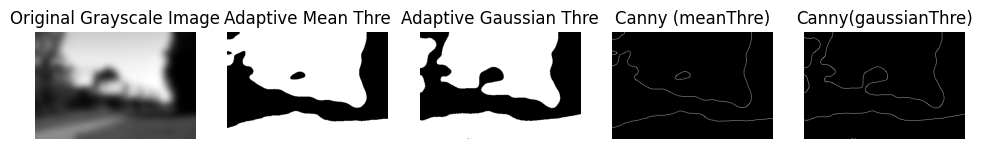

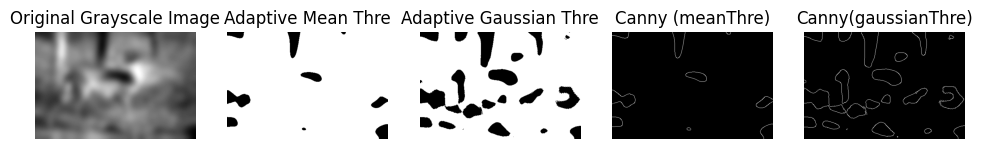

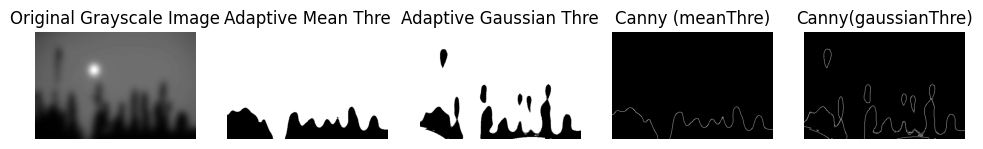

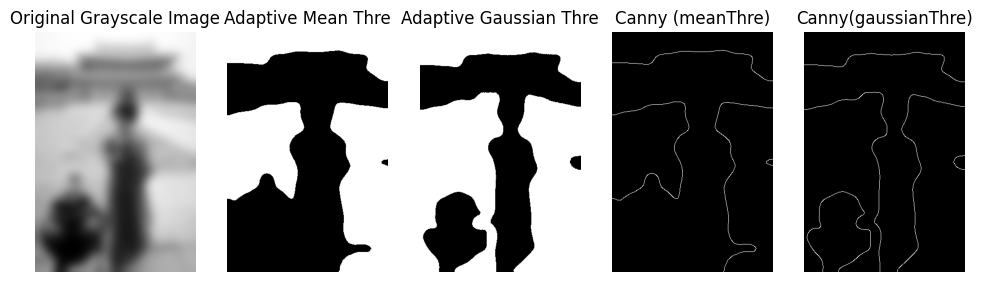

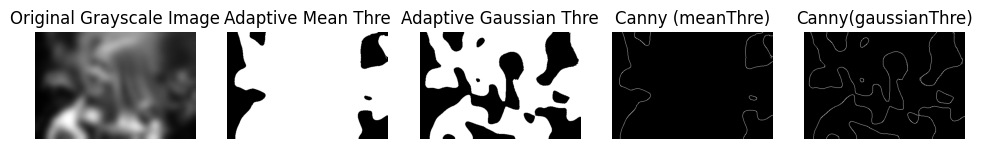

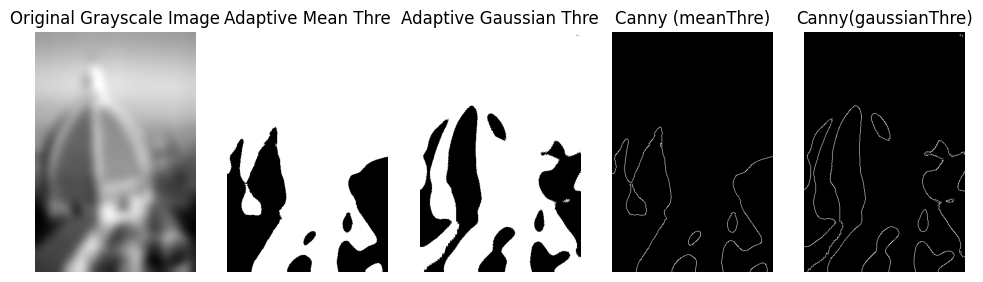

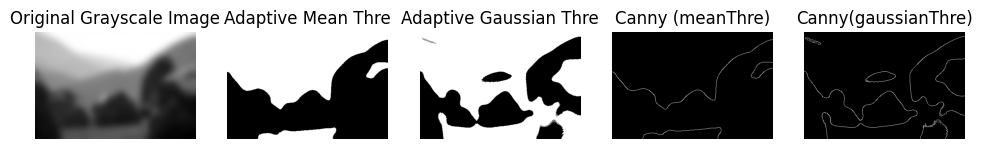

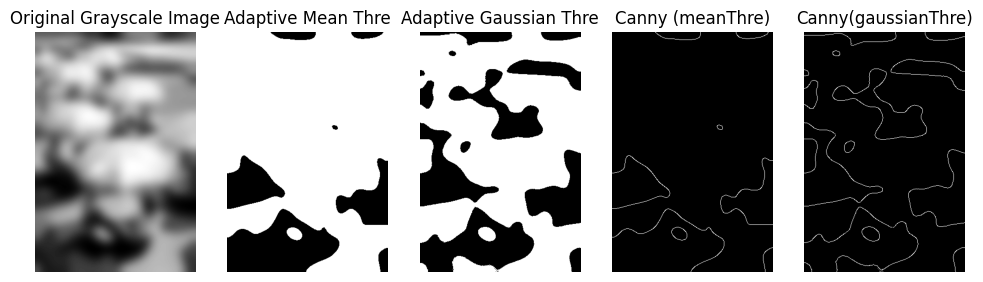

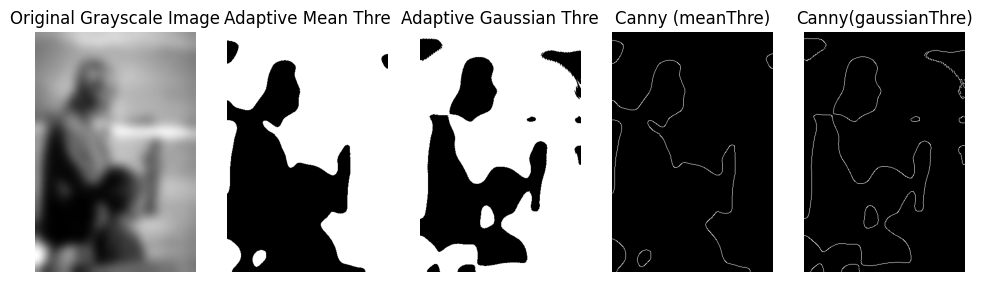

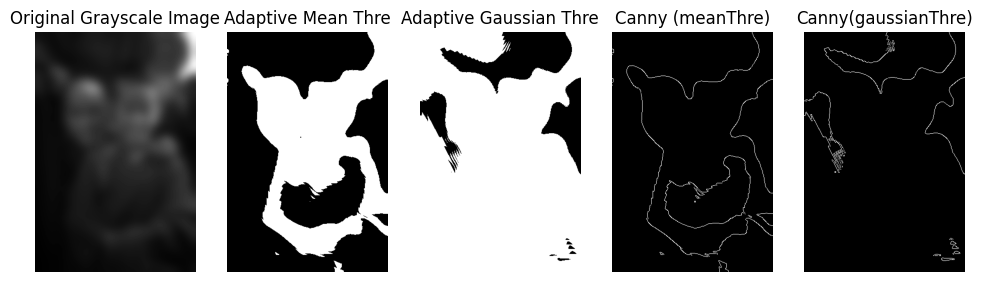

In [ ]:
for selected_sample_name in selected_sample_names:


  img = dataset.read_image(selected_sample_name)
  img = np.array(img, dtype=np.uint8)
  img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)


  # 블러링
  gblur_img  = cv2.GaussianBlur(img, (65, 65), sigmaX = 0, sigmaY = 0)
  mblur_img  = cv2.medianBlur(img, ksize=17)


  # Apply Adaptive Mean Thresholding
  adaptive_thresh_mean = cv2.adaptiveThreshold(
      gblur_img, 255, cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY, 1111, 10)

  # Apply Adaptive Gaussian Thresholding
  adaptive_thresh_gaussian = cv2.adaptiveThreshold(
      gblur_img, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY, 399, 10)


  # Apply Canny Edge Detection
  canny_edge = cv2.Canny(adaptive_thresh_mean, threshold1=0, threshold2=255)

  canny_edge_gaussian = cv2.Canny(adaptive_thresh_gaussian, threshold1=0, threshold2=255)


  # Display the original and adaptive thresholded images
  plt.figure(figsize=(12, 9))
  plt.subplot(1, 5, 1)
  plt.title('Original Grayscale Image')
  plt.imshow(gblur_img, cmap='gray')
  plt.axis('off')

  plt.subplot(1, 5, 2)
  plt.title('Adaptive Mean Thre')
  plt.imshow(adaptive_thresh_mean, cmap='gray')
  plt.axis('off')

  plt.subplot(1, 5, 3)
  plt.title('Adaptive Gaussian Thre')
  plt.imshow(adaptive_thresh_gaussian, cmap='gray')
  plt.axis('off')

  plt.subplot(1, 5, 4)
  plt.title('Canny (meanThre)')
  plt.imshow(canny_edge, cmap='gray')
  plt.axis('off')


  # Display the Canny edge detection result
  plt.subplot(1, 5, 5)
  plt.title('Canny(gaussianThre)')
  plt.imshow(canny_edge_gaussian, cmap='gray')
  plt.axis('off')

  plt.show()



# inverse 적용

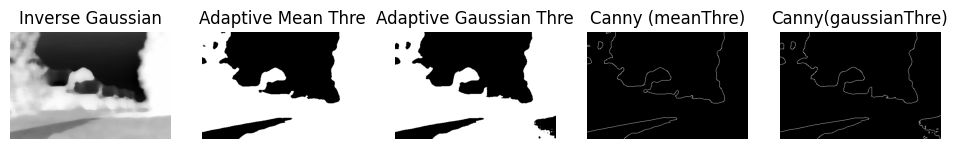

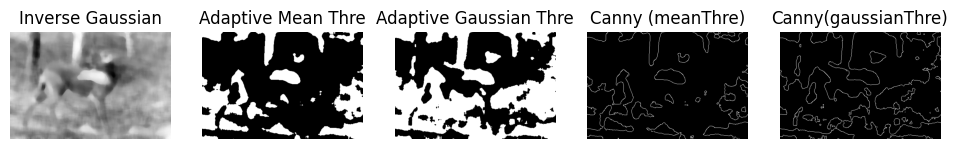

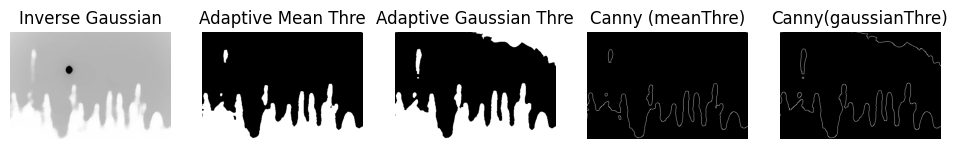

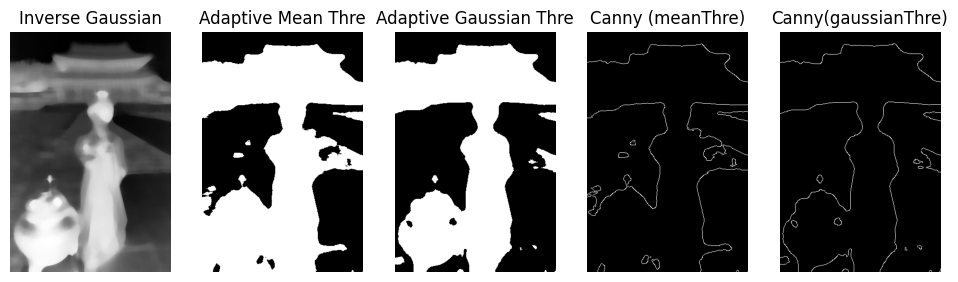

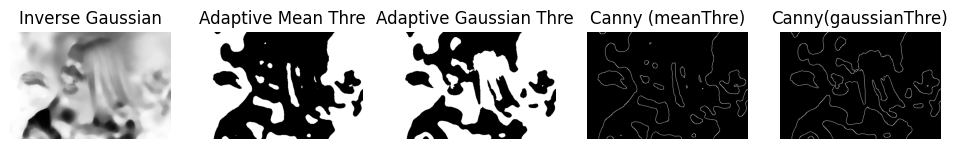

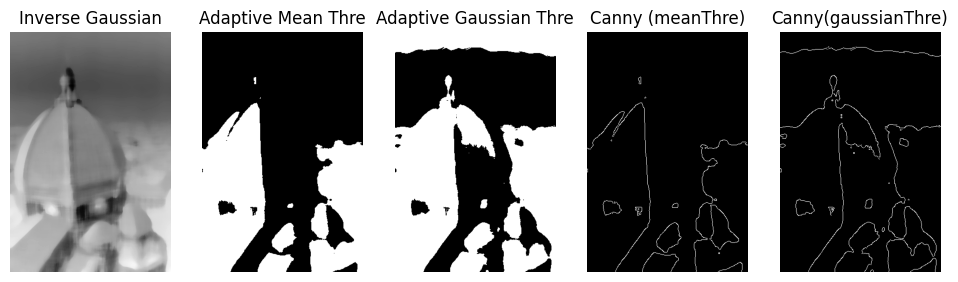

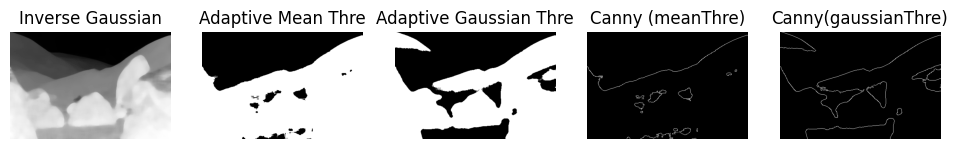

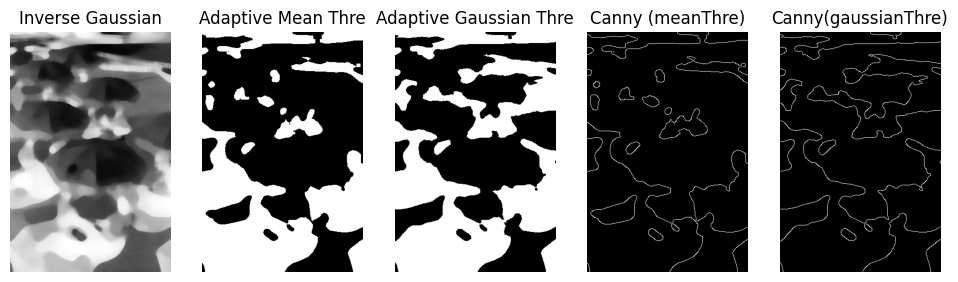

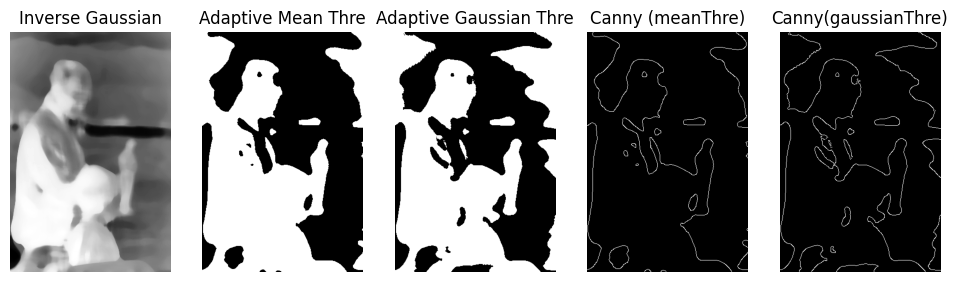

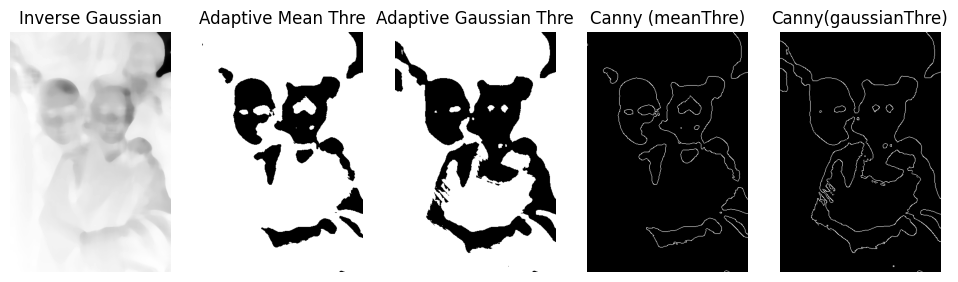

In [ ]:
for selected_sample_name in selected_sample_names:


  img = dataset.read_image(selected_sample_name)
  # inverse
  img = cv2.bitwise_not(img)
  img = np.array(img, dtype=np.uint8)
  img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)


  # 블러링
  gblur_img  = cv2.GaussianBlur(img, (17, 17), sigmaX = 0, sigmaY = 0)
  mblur_img  = cv2.medianBlur(img, ksize=17)


  # Apply Adaptive Mean Thresholding
  adaptive_thresh_mean = cv2.adaptiveThreshold(
      mblur_img, 255, cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY, 799, 5)

  # Apply Adaptive Gaussian Thresholding
  adaptive_thresh_gaussian = cv2.adaptiveThreshold(
      mblur_img, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY, 699, 5)


  # Apply Canny Edge Detection
  canny_edge = cv2.Canny(adaptive_thresh_mean, threshold1=0, threshold2=255)

  canny_edge_gaussian = cv2.Canny(adaptive_thresh_gaussian, threshold1=0, threshold2=255)


  # Display the original and adaptive thresholded images
  plt.figure(figsize=(12, 9))
  plt.subplot(1, 5, 1)
  plt.title('Inverse Gaussian')
  plt.imshow(mblur_img, cmap='gray')
  plt.axis('off')

  plt.subplot(1, 5, 2)
  plt.title('Adaptive Mean Thre')
  plt.imshow(adaptive_thresh_mean, cmap='gray')
  plt.axis('off')

  plt.subplot(1, 5, 3)
  plt.title('Adaptive Gaussian Thre')
  plt.imshow(adaptive_thresh_gaussian, cmap='gray')
  plt.axis('off')

  plt.subplot(1, 5, 4)
  plt.title('Canny (meanThre)')
  plt.imshow(canny_edge, cmap='gray')
  plt.axis('off')


  # Display the Canny edge detection result
  plt.subplot(1, 5, 5)
  plt.title('Canny(gaussianThre)')
  plt.imshow(canny_edge_gaussian, cmap='gray')
  plt.axis('off')

  plt.show()



## ⭐️⭐️blend (
1. gray + gaussian blur
2. gray + median blur +  adaptive_thresh_gaussian )


In [ ]:
data_dic = {}
for selected_sample_name in dataset.sample_names:


  image = dataset.read_image(selected_sample_name)
  # histogram normalize
  image = cv2.normalize(image, None, 0, 255, cv2.NORM_MINMAX)
  image = np.array(image)
  image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)


  # 블러링
  gblur_img  = cv2.GaussianBlur(image, (13, 13), sigmaX = 0, sigmaY = 0)
  mblur_img  = cv2.medianBlur(image, ksize=17)


  # # Apply Adaptive Mean Thresholding
  # adaptive_thresh_mean = cv2.adaptiveThreshold(
  #     mblur_img, 255, cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY, 699, 5)

  # Apply Adaptive Gaussian Thresholding
  adaptive_thresh_gaussian = cv2.adaptiveThreshold(
      mblur_img, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY, 401, 3)


  # inverse + median blur + adaptive gaussian
  alpha = 0.1
  blend = cv2.addWeighted(gblur_img, 1-alpha, adaptive_thresh_gaussian, alpha, 0)


  # Apply Canny Edge Detection
  canny_edge = cv2.Canny(blend, threshold1=100, threshold2=230)

  data_dic[selected_sample_name] = canny_edge


  # Display the original and adaptive thresholded images
  plt.figure(figsize=(12, 9))
  plt.subplot(1, 5, 1)
  plt.title('gaussian blur')
  plt.imshow(gblur_img, cmap='gray')
  plt.axis('off')

  plt.subplot(1, 5, 3)
  plt.title('adaptive gauss')
  plt.imshow(adaptive_thresh_gaussian, cmap='gray')
  plt.axis('off')

  plt.subplot(1, 5, 2)
  plt.title('median blur')
  plt.imshow(mblur_img, cmap='gray')
  plt.axis('off')

  plt.subplot(1, 5, 4)
  plt.title('blend(1+3)')
  plt.imshow(blend, cmap='gray')
  plt.axis('off')

  plt.subplot(1, 5, 5)
  plt.title('Canny')
  plt.imshow(canny_edge, cmap='gray')
  plt.axis('off')

  plt.show()

np.save('test04_adapG_all.npy', data_dic)

Output hidden; open in https://colab.research.google.com to view.

## blend01 (
1. gray + gaussian blur
2. gray + median blur +  adaptive_thresh_MEAN )


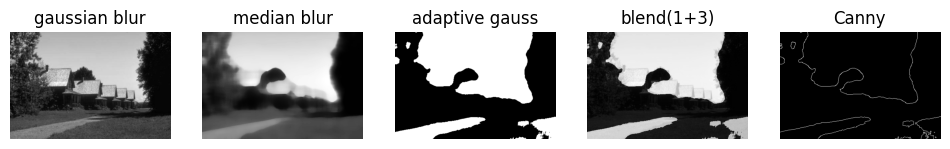

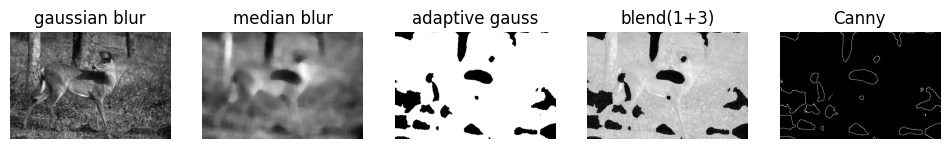

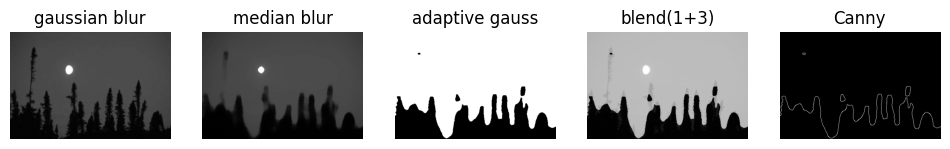

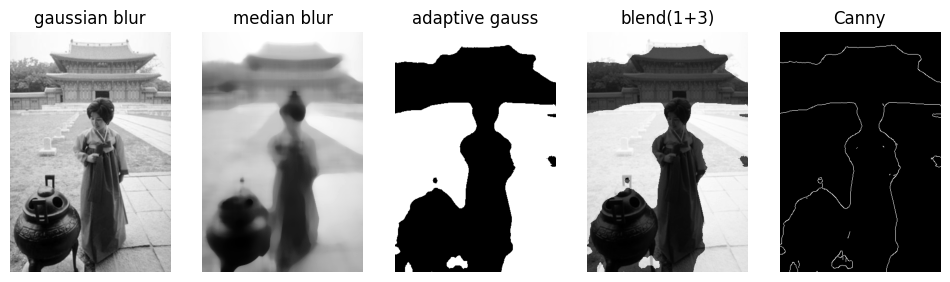

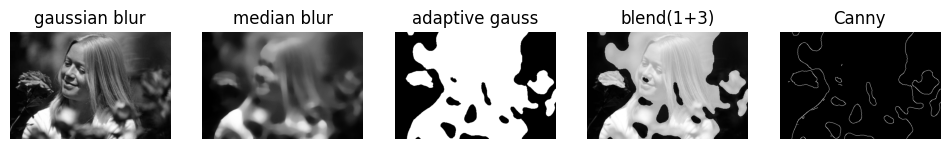

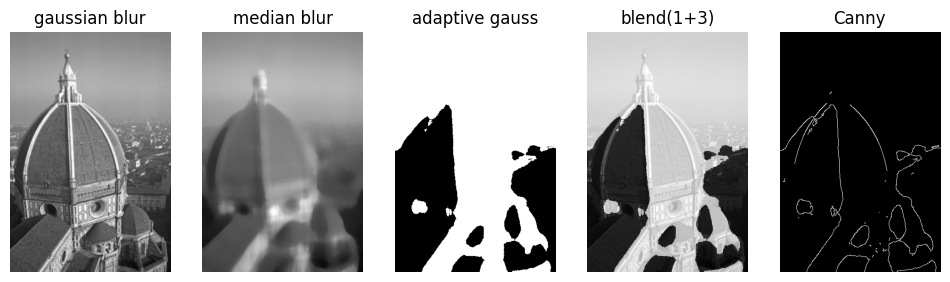

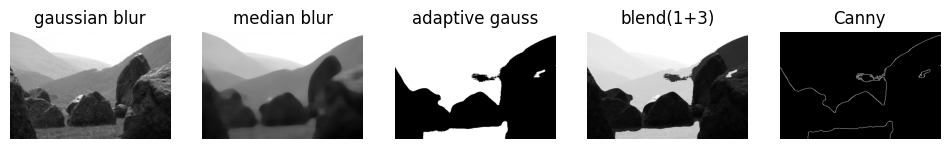

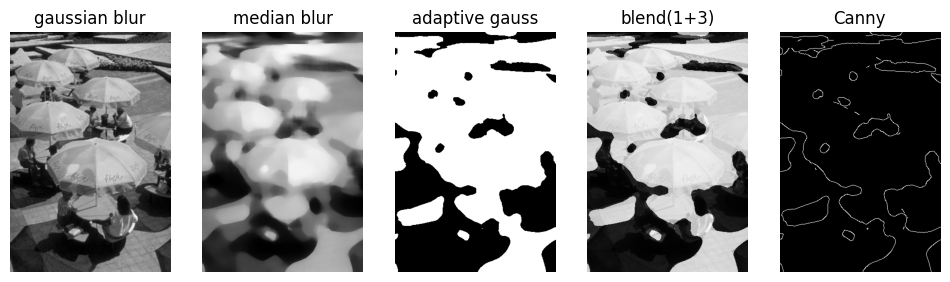

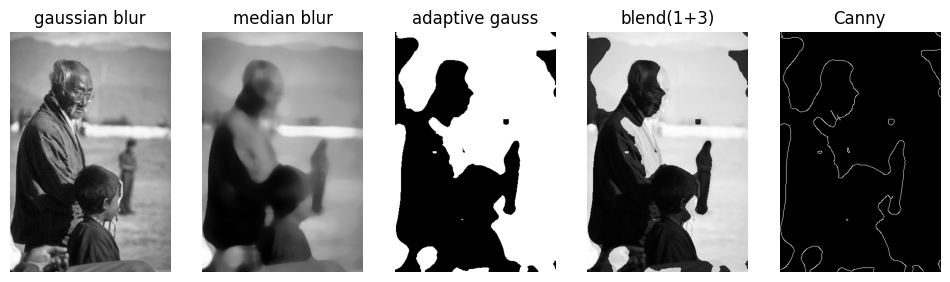

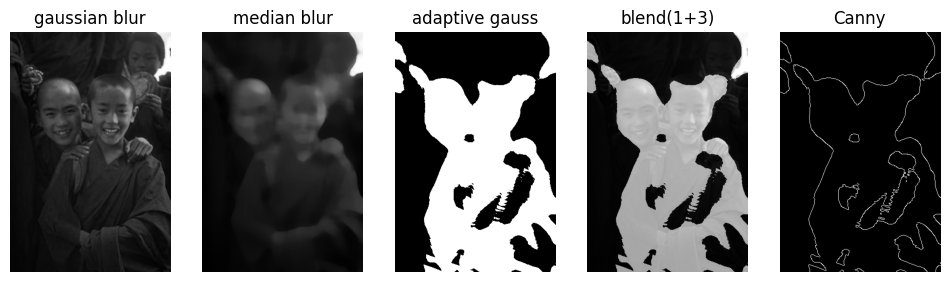

In [ ]:
for selected_sample_name in selected_sample_names:


  image = dataset.read_image(selected_sample_name)
  # histogram normalize
  image = cv2.normalize(image, None, 0, 255, cv2.NORM_MINMAX)
  image = np.array(image)
  image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)


  # 블러링
  gblur_img  = cv2.GaussianBlur(image, (3, 3), sigmaX = 0, sigmaY = 0)
  mblur_img  = cv2.medianBlur(image, ksize=23)


  # # Apply Adaptive Mean Thresholding
  adaptive_thresh_mean = cv2.adaptiveThreshold(
      mblur_img, 255, cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY, 699, 5)

  # # Apply Adaptive Gaussian Thresholding
  # adaptive_thresh_gaussian = cv2.adaptiveThreshold(
  #     mblur_img, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY, 999, 3)


  # inverse + median blur + adaptive gaussian
  alpha = 0.6
  blend = cv2.addWeighted(gblur_img, 1-alpha, adaptive_thresh_mean, alpha, 0)


  # Apply Canny Edge Detection
  canny_edge = cv2.Canny(blend, threshold1=200, threshold2=255)


  # Display the original and adaptive thresholded images
  plt.figure(figsize=(12, 9))
  plt.subplot(1, 5, 1)
  plt.title('gaussian blur')
  plt.imshow(gblur_img, cmap='gray')
  plt.axis('off')

  plt.subplot(1, 5, 3)
  plt.title('adaptive gauss')
  plt.imshow(adaptive_thresh_mean, cmap='gray')
  plt.axis('off')

  plt.subplot(1, 5, 2)
  plt.title('median blur')
  plt.imshow(mblur_img, cmap='gray')
  plt.axis('off')

  plt.subplot(1, 5, 4)
  plt.title('blend(1+3)')
  plt.imshow(blend, cmap='gray')
  plt.axis('off')

  plt.subplot(1, 5, 5)
  plt.title('Canny')
  plt.imshow(canny_edge, cmap='gray')
  plt.axis('off')

  plt.show()



## blend02 (
1. gray
2. gray + gaussan blur +  adaptive_thresh_gaussian )

어우 얘는 진짜 아님

In [ ]:
data_dic = {}
for selected_sample_name in dataset.sample_names:


  image = dataset.read_image(selected_sample_name)
  image = np.array(image)
  image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
  # inverse
  img = dataset.read_image(selected_sample_name)
  img = cv2.bitwise_not(img)
  img = np.array(img, dtype=np.uint8)
  img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)


  # 블러링
  blur_img  = cv2.blur(image, (9, 9))
  gblur_img  = cv2.GaussianBlur(image, (33, 33), sigmaX = 0, sigmaY = 0)
  # mblur_img  = cv2.medianBlur(image, ksize=25)


  # Apply Adaptive Mean Thresholding
  # adaptive_thresh_mean = cv2.adaptiveThreshold(
  #     gblur_img, 255, cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY, 699, 5)

  # Apply Adaptive Gaussian Thresholding
  adaptive_thresh_gaussian = cv2.adaptiveThreshold(
      gblur_img, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY, 999, 3)


  # inverse + median blur + adaptive gaussian
  alpha = 0.15
  blend = cv2.addWeighted(image, 1-alpha, adaptive_thresh_gaussian, alpha, 0)


  # Apply Canny Edge Detection
  canny_edge = cv2.Canny(blend, threshold1=50, threshold2=230)

  data_dic[selected_sample_name] = canny_edge


  # Display the original and adaptive thresholded images
  plt.figure(figsize=(12, 9))
  plt.subplot(1, 5, 1)
  plt.title('origin')
  plt.imshow(image, cmap='gray')
  plt.axis('off')

  plt.subplot(1, 5, 3)
  plt.title('adaptive gauss')
  plt.imshow(adaptive_thresh_gaussian, cmap='gray')
  plt.axis('off')

  plt.subplot(1, 5, 2)
  plt.title('gaussian blur')
  plt.imshow(gblur_img, cmap='gray')
  plt.axis('off')

  plt.subplot(1, 5, 4)
  plt.title('blend(1+3)')
  plt.imshow(blend, cmap='gray')
  plt.axis('off')

  plt.subplot(1, 5, 5)
  plt.title('Canny')
  plt.imshow(canny_edge, cmap='gray')
  plt.axis('off')

  plt.show()


np.save('test05_worst_all.npy', data_dic)

Output hidden; open in https://colab.research.google.com to view.

## ⭐️⭐️gaussian blur + median blur

In [ ]:
data_dic = {}
for selected_sample_name in dataset.sample_names:

  image = dataset.read_image(selected_sample_name)
  image = cv2.normalize(image, None, 0, 255, cv2.NORM_MINMAX)
  image = np.array(image)
  image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

  # 블러링
  gblur_img  = cv2.GaussianBlur(image, (11, 11), sigmaX = 0, sigmaY = 0)
  mblur_img  = cv2.medianBlur(image, ksize=17)

  # median blur + adaptive gaussian
  alpha = 0.5
  blend = cv2.addWeighted(gblur_img, 1-alpha, mblur_img, alpha, 0)

  # Apply Canny Edge Detection
  canny_edge = cv2.Canny(blend, threshold1=3, threshold2=80)

  #print(canny_edge)
  data_dic[selected_sample_name] = canny_edge

  #np.save('test01_2blur.npy', data_dic)


  # Display the original and adaptive thresholded images
  plt.figure(figsize=(12, 9))
  plt.subplot(1, 5, 1)
  plt.title('origin')
  plt.imshow(image, cmap='gray')
  plt.axis('off')

  plt.subplot(1, 5, 2)
  plt.title('gaussian blur')
  plt.imshow(gblur_img, cmap='gray')
  plt.axis('off')

  plt.subplot(1, 5, 3)
  plt.title('median blur')
  plt.imshow(mblur_img, cmap='gray')
  plt.axis('off')

  plt.subplot(1, 5, 4)
  plt.title('blend(2+3)')
  plt.imshow(blend, cmap='gray')
  plt.axis('off')

  plt.subplot(1, 5, 5)
  plt.title('Canny')
  plt.imshow(canny_edge, cmap='gray')
  plt.axis('off')

  plt.show()

np.save('test02_2_2blur_all.npy', data_dic)


Output hidden; open in https://colab.research.google.com to view.

## ⭐️⭐️죄다 inverse + gau blur + median blur

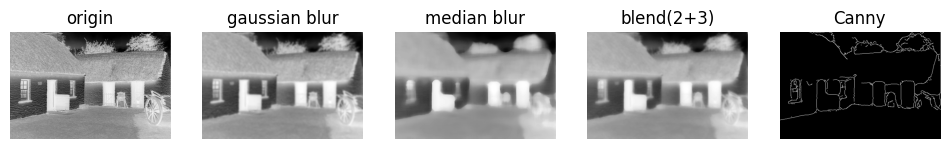

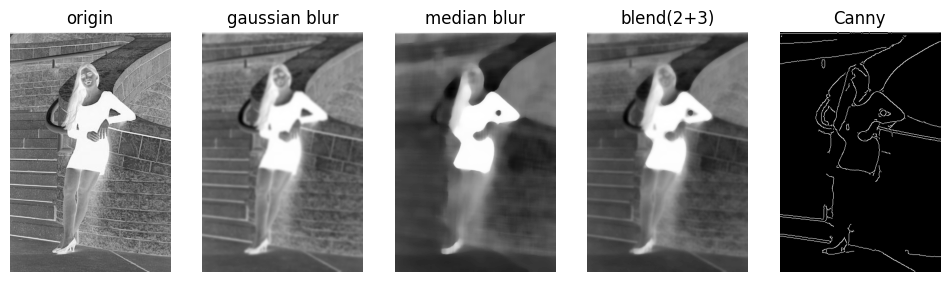

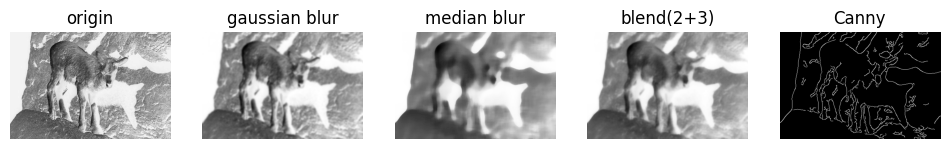

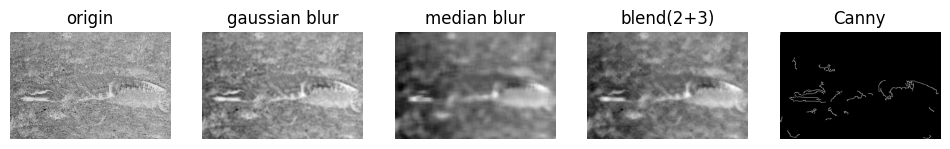

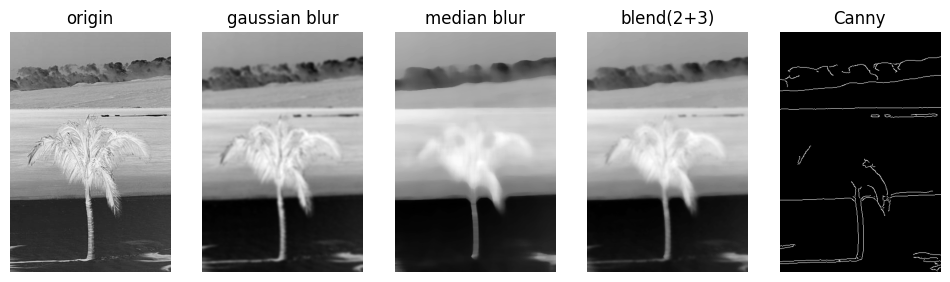

...

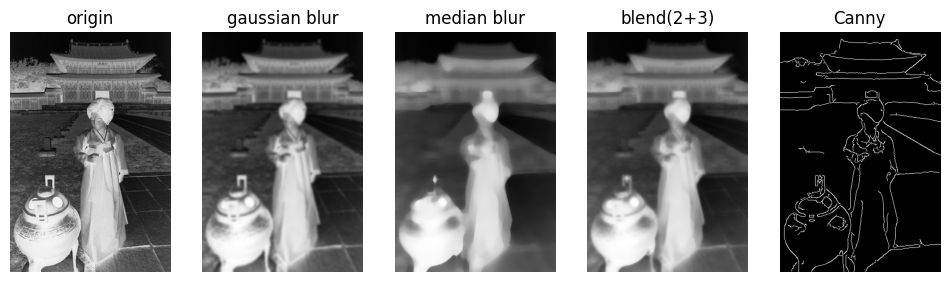

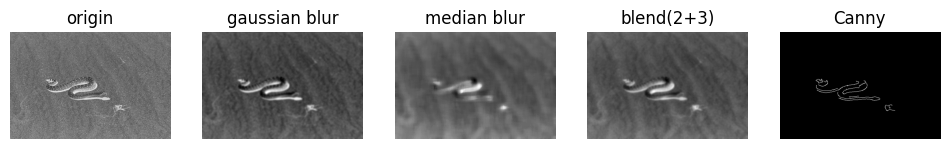

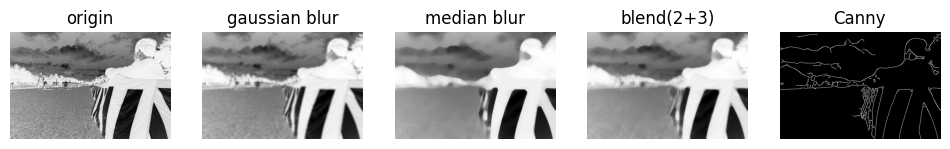

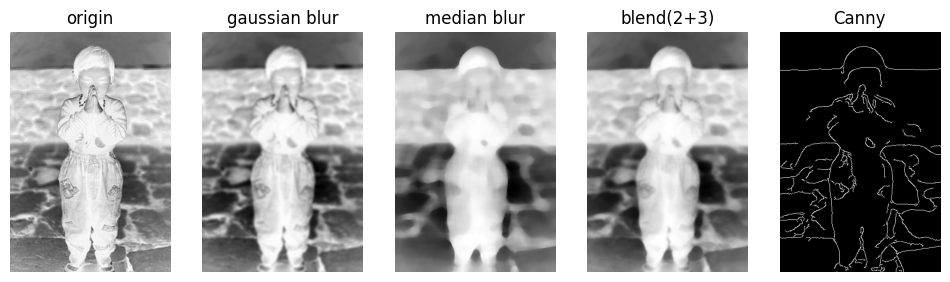

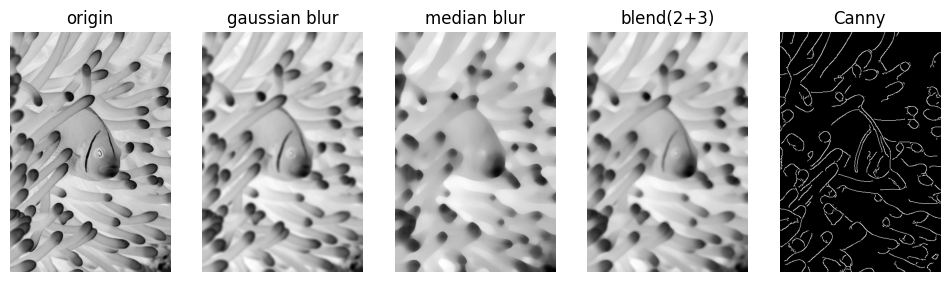

KeyboardInterrupt: 

In [ ]:
for selected_sample_name in dataset.sample_names:


  image = dataset.read_image(selected_sample_name)
  image = cv2.normalize(image, None, 0, 255, cv2.NORM_MINMAX)
  # inverse
  img = cv2.bitwise_not(image)
  img = np.array(img, dtype=np.uint8)
  img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)


  # 블러링
  gblur_img  = cv2.GaussianBlur(img, (11, 11), sigmaX = 0, sigmaY = 0)
  mblur_img  = cv2.medianBlur(img, ksize=19)

  # median blur + adaptive gaussian
  alpha = 0.5
  blend = cv2.addWeighted(gblur_img, 1-alpha, mblur_img, alpha, 0)


  # Apply Canny Edge Detection
  canny_edge = cv2.Canny(blend, threshold1=6, threshold2=70)


  # Display the original and adaptive thresholded images
  plt.figure(figsize=(12, 9))
  plt.subplot(1, 5, 1)
  plt.title('origin')
  plt.imshow(img, cmap='gray')
  plt.axis('off')

  plt.subplot(1, 5, 2)
  plt.title('gaussian blur')
  plt.imshow(gblur_img, cmap='gray')
  plt.axis('off')

  plt.subplot(1, 5, 3)
  plt.title('median blur')
  plt.imshow(mblur_img, cmap='gray')
  plt.axis('off')

  plt.subplot(1, 5, 4)
  plt.title('blend(2+3)')
  plt.imshow(blend, cmap='gray')
  plt.axis('off')

  plt.subplot(1, 5, 5)
  plt.title('Canny')
  plt.imshow(canny_edge, cmap='gray')
  plt.axis('off')

  plt.show()



## ⭐️bilateral filter
blend ( mblur + bilater )

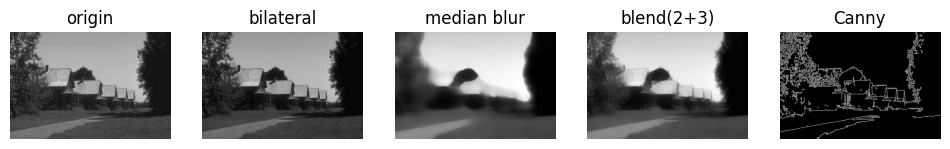

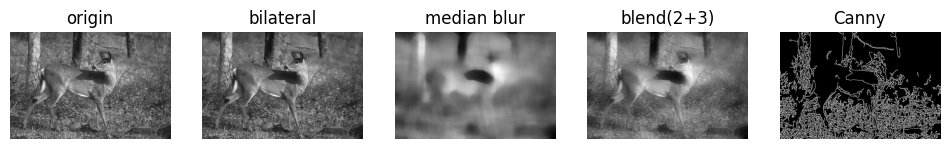

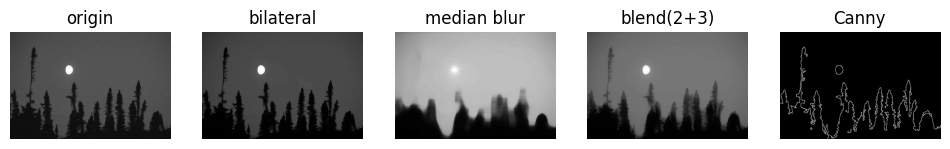

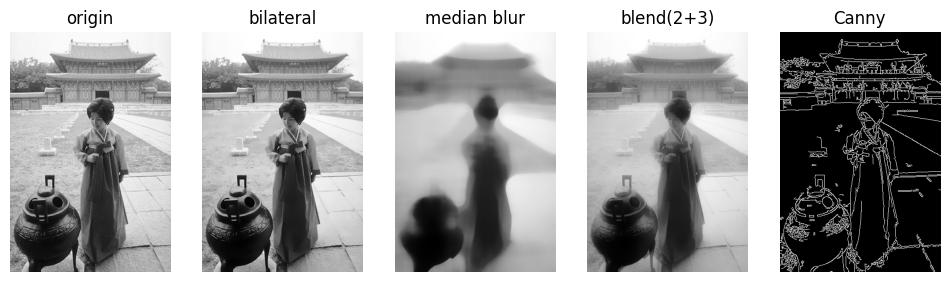

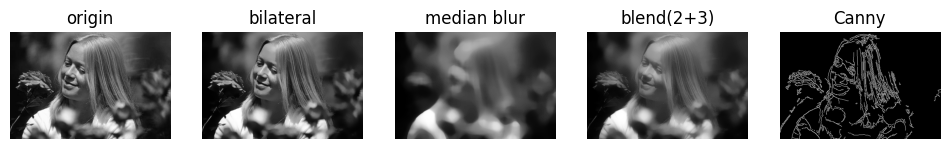

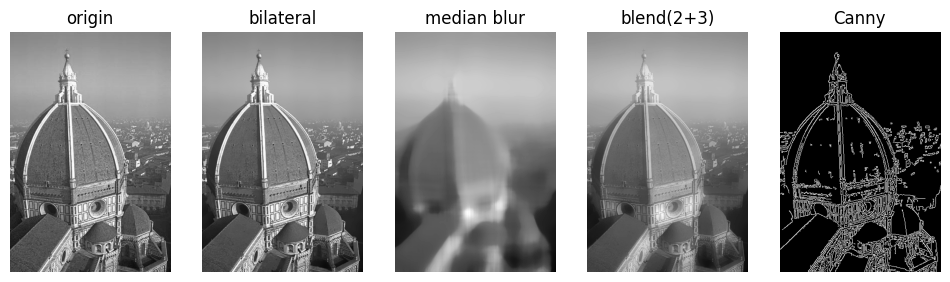

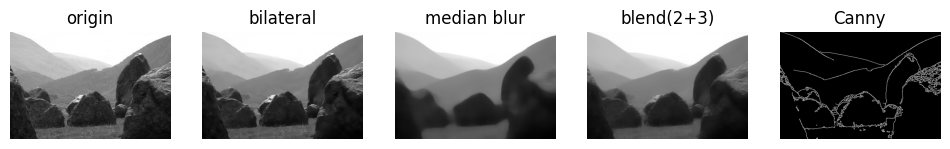

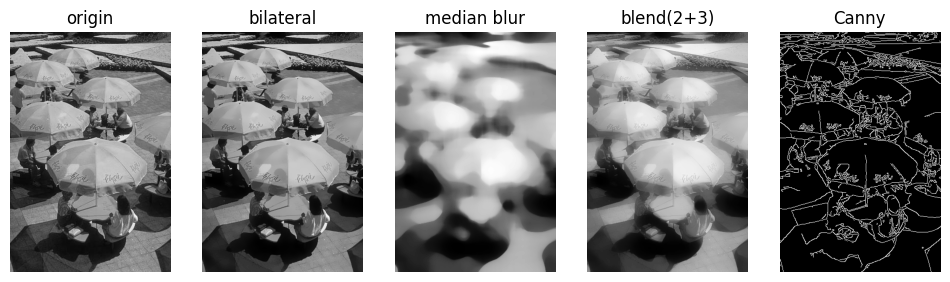

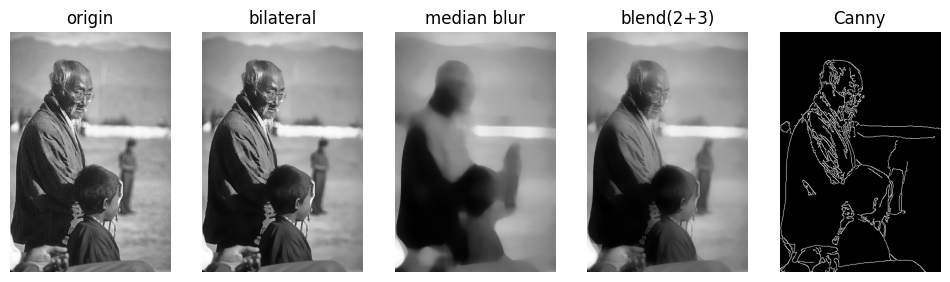

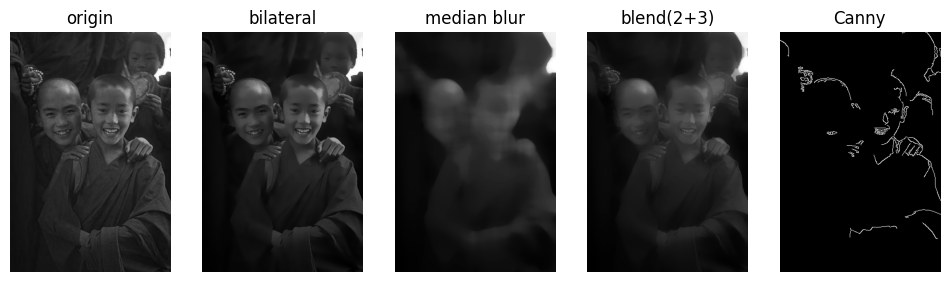

In [ ]:
for selected_sample_name in selected_sample_names:


  image = dataset.read_image(selected_sample_name)
  image = cv2.normalize(image, None, 0, 255, cv2.NORM_MINMAX)
  image = np.array(image)
  image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

  # 블러링
  #gblur_img  = cv2.GaussianBlur(image, (11, 11), sigmaX = 0, sigmaY = 0)
  mblur_img  = cv2.medianBlur(image, ksize=33)

  # bilateral
  bi = cv2.bilateralFilter(image, -1, 10, 5)


  # median blur + adaptive gaussian
  alpha = 0.6
  blend = cv2.addWeighted(bi, 1-alpha, mblur_img, alpha, 0)

  # Apply Canny Edge Detection
  canny_edge = cv2.Canny(blend, threshold1=30, threshold2=100)


  # Display the original and adaptive thresholded images
  plt.figure(figsize=(12, 9))
  plt.subplot(1, 5, 1)
  plt.title('origin')
  plt.imshow(image, cmap='gray')
  plt.axis('off')

  plt.subplot(1, 5, 2)
  plt.title('bilateral')
  plt.imshow(bi, cmap='gray')
  plt.axis('off')

  plt.subplot(1, 5, 3)
  plt.title('median blur')
  plt.imshow(mblur_img, cmap='gray')
  plt.axis('off')

  plt.subplot(1, 5, 4)
  plt.title('blend(2+3)')
  plt.imshow(blend, cmap='gray')
  plt.axis('off')

  plt.subplot(1, 5, 5)
  plt.title('Canny')
  plt.imshow(canny_edge, cmap='gray')
  plt.axis('off')

  plt.show()



In [ ]:
# 무한 bilateral
data_dic = {}
for selected_sample_name in dataset.sample_names:

  image = dataset.read_image(selected_sample_name)
  image = cv2.normalize(image, None, 0, 255, cv2.NORM_MINMAX)
  image = np.array(image)
  image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

  # bilateral
  bi = cv2.bilateralFilter(image, 80, 30, 30)
  bi2 = cv2.bilateralFilter(bi, 80, 30, 30)
  bi3 = cv2.bilateralFilter(bi2, 80, 30, 30)

  #data_dic[selected_sample_name] = canny_edge

  # Display the original and adaptive thresholded images
  plt.figure(figsize=(12, 9))
  plt.subplot(1, 3, 1)
  plt.title('origin')
  plt.imshow(image, cmap='gray')
  plt.axis('off')

  plt.subplot(1, 3, 2)
  plt.title('bilateral')
  plt.imshow(bi, cmap='gray')
  plt.axis('off')

  plt.subplot(1, 3, 3)
  plt.title('bilateral')
  plt.imshow(bi2, cmap='gray')
  plt.axis('off')

  plt.show()
  #np.save('/content/gdrive/MyDrive/CV/termProject/predictions/????????????.npy', data_dic)



# K-means

## basic K-means

In [ ]:
for selected_sample_name in selected_sample_names:


  image = dataset.read_image(selected_sample_name)
  #normalize
  image = cv2.normalize(image, None, 0, 255, cv2.NORM_MINMAX)
  # image = np.array(image)
  # image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

  # Reshape image to be a list of pixels
  pixels = image.reshape((-1, 3)) # 이미지를 2d로 변환 (hight, width의 두)
  pixels = np.float32(pixels) ### 픽셀의 x y coordination ???????????????????????????????? 고려하면 더 좋아진다

  # Define criteria and apply KMeans
  criteria = (cv2.TERM_CRITERIA_MAX_ITER + cv2.TERM_CRITERIA_EPS, 300, 0.2)
  k = 3 # 2로 하면 흑백됨
  _, labels, centers = cv2.kmeans(pixels, k, None, criteria=criteria, attempts=10, flags=cv2.KMEANS_RANDOM_CENTERS)

  # centers은 각 center에 대한 RGB value

  # Convert centers to uint8 and map labels to corresponding pixel values
  centers = np.uint8(centers)
  segmented_image = centers[labels.flatten()] # 모든 pixel value를 label에 맞는 RGB 값으로 변환
  segmented_image = segmented_image.reshape(image.shape)

  # Display the images
  plt.figure(figsize=(12, 6))
  plt.subplot(1, 2, 1)
  plt.title('Image')
  plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
  plt.axis('off')

  plt.subplot(1, 2, 2)
  plt.title('K-Means Segmentation (k=3)')
  plt.imshow(cv2.cvtColor(segmented_image, cv2.COLOR_BGR2RGB))
  plt.axis('off')
  plt.show()

Output hidden; open in https://colab.research.google.com to view.

## gray + {gaussian, median} blur + k-means

In [ ]:
for selected_sample_name in selected_sample_names:


  image = dataset.read_image(selected_sample_name)
  #normalize
  image = cv2.normalize(image, None, 0, 255, cv2.NORM_MINMAX)
  image = np.array(image)
  #image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

  gblur_img  = cv2.GaussianBlur(image, (3, 3), sigmaX = 0, sigmaY = 0)
  mblur_img  = cv2.medianBlur(image, ksize=15)

  # Reshape image to be a list of pixels
  pixels = mblur_img.reshape((-1, 3))
  pixels = np.float32(pixels)

  # Define criteria and apply KMeans
  criteria = (cv2.TERM_CRITERIA_MAX_ITER + cv2.TERM_CRITERIA_EPS, 300, 0.2)
  k = 3 # 몇 개의 색으로 표현할지
  _, labels, centers = cv2.kmeans(pixels, k, None, criteria=criteria, attempts=10, flags=cv2.KMEANS_RANDOM_CENTERS)

  # Convert centers to uint8 and map labels to corresponding pixel values
  centers = np.uint8(centers)
  segmented_image = centers[labels.flatten()] # 모든 pixel value를 label에 맞는 RGB 값으로 변환
  segmented_image = segmented_image.reshape(image.shape)

  # Display the images
  plt.figure(figsize=(12, 6))
  plt.subplot(1, 3, 1)
  plt.title('Image')
  plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
  plt.axis('off')

  plt.subplot(1, 3, 2)
  plt.title('gaussian blur')
  plt.imshow(cv2.cvtColor(mblur_img, cv2.COLOR_BGR2RGB))
  plt.axis('off')

  plt.subplot(1, 3, 3)
  plt.title('K-Means Segmentation (k=3)')
  plt.imshow(cv2.cvtColor(segmented_image, cv2.COLOR_BGR2RGB))
  plt.axis('off')
  plt.show()

Output hidden; open in https://colab.research.google.com to view.

## k means(mean blur) + gaussian blur

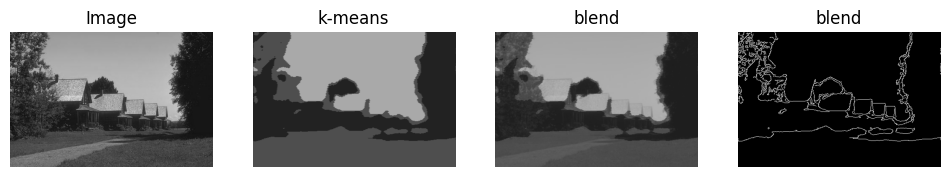

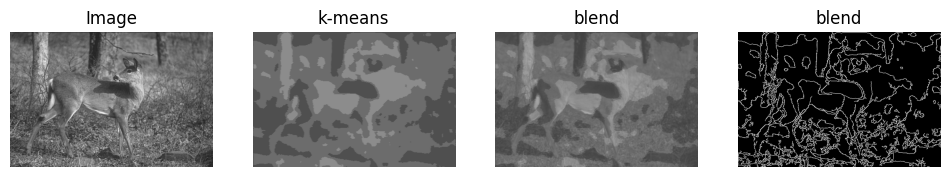

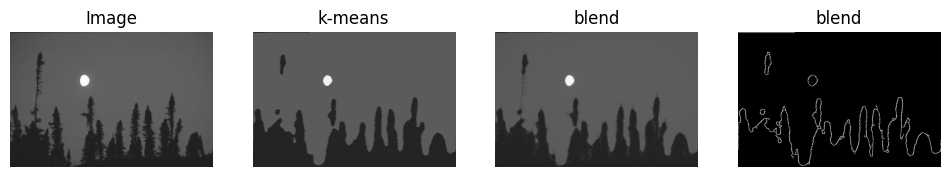

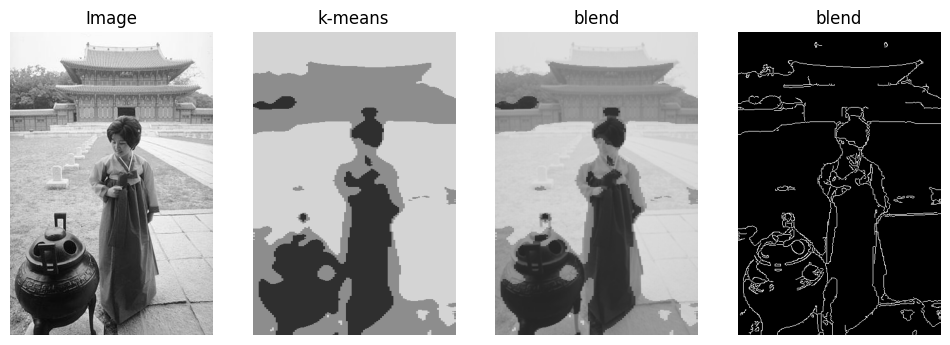

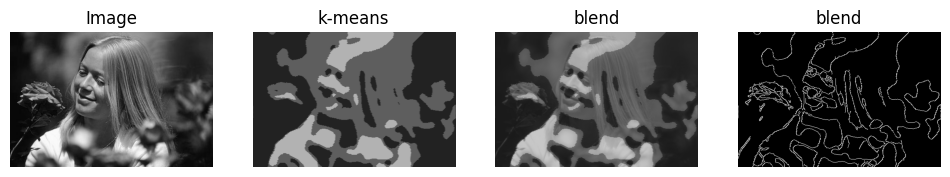

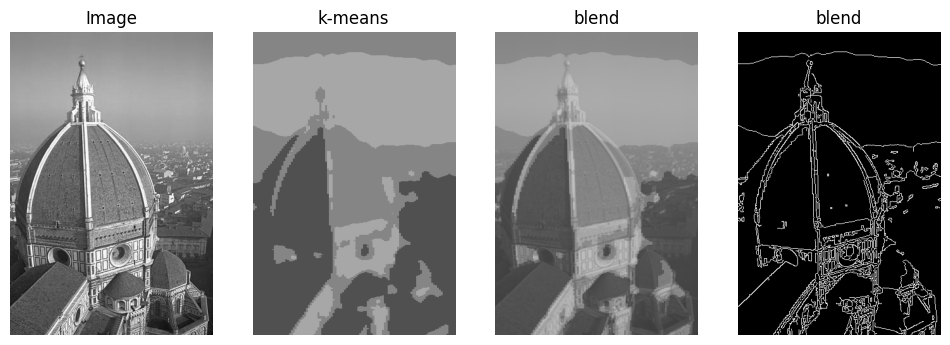

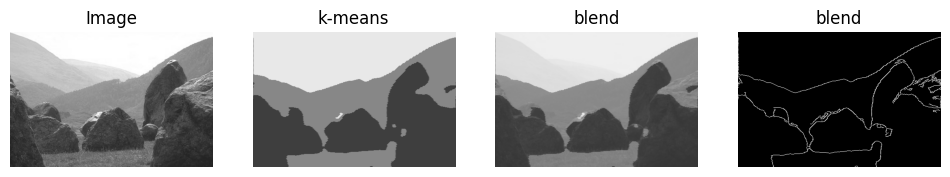

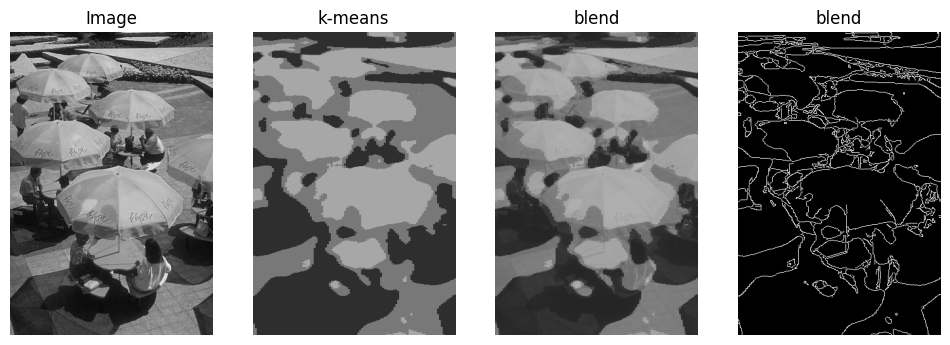

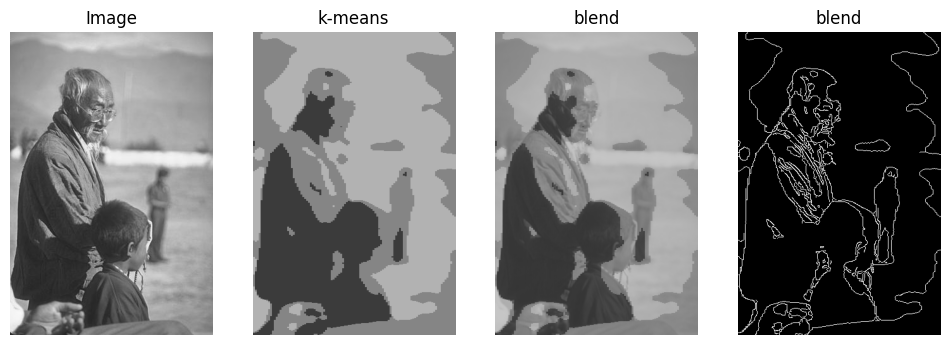

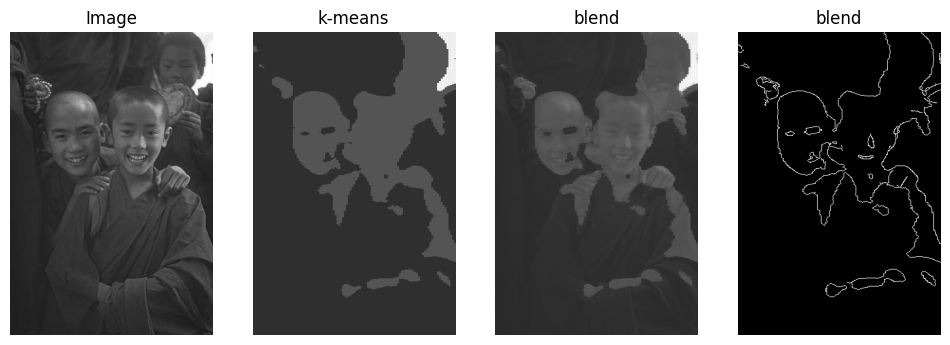

In [ ]:
for selected_sample_name in selected_sample_names:


  image = dataset.read_image(selected_sample_name)
  #normalize
  image = cv2.normalize(image, None, 0, 255, cv2.NORM_MINMAX)
  image = np.array(image)
  image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

  gblur_img  = cv2.GaussianBlur(image, (3, 3), sigmaX = 0, sigmaY = 0)
  mblur_img  = cv2.medianBlur(image, ksize=15)

  # Reshape image to be a list of pixels
  pixels = mblur_img.reshape((-1, 3))
  pixels = np.float32(pixels)

  # Define criteria and apply KMeans
  criteria = (cv2.TERM_CRITERIA_MAX_ITER + cv2.TERM_CRITERIA_EPS, 300, 0.2)
  k = 3 # 몇 개의 색으로 표현할지
  _, labels, centers = cv2.kmeans(pixels, k, None, criteria=criteria, attempts=10, flags=cv2.KMEANS_RANDOM_CENTERS)

  # Convert centers to uint8 and map labels to corresponding pixel values
  centers = np.uint8(centers)
  segmented_image = centers[labels.flatten()] # 모든 pixel value를 label에 맞는 RGB 값으로 변환
  segmented_image = segmented_image.reshape(image.shape)



  # median blur + adaptive gaussian
  alpha = 0.7
  blend = cv2.addWeighted(gblur_img, 1-alpha, segmented_image, alpha, 0)

  # Apply Canny Edge Detection
  canny_edge = cv2.Canny(blend, threshold1=30, threshold2=100)



  # Display the images
  plt.figure(figsize=(12, 6))
  plt.subplot(1, 4, 1)
  plt.title('Image')
  plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
  plt.axis('off')

  plt.subplot(1, 4, 2)
  plt.title('k-means')
  plt.imshow(cv2.cvtColor(segmented_image, cv2.COLOR_BGR2RGB))
  plt.axis('off')

  plt.subplot(1, 4, 3)
  plt.title('blend')
  plt.imshow(cv2.cvtColor(blend, cv2.COLOR_BGR2RGB))
  plt.axis('off')

  plt.subplot(1, 4, 4)
  plt.title('blend')
  plt.imshow(cv2.cvtColor(canny_edge, cv2.COLOR_BGR2RGB))
  plt.axis('off')
  plt.show()

## only Graph cut

In [ ]:
from skimage import data, color, graph
from skimage.color import rgb2lab, label2rgb
from skimage.segmentation import slic, mark_boundaries

for selected_sample_name in selected_sample_names:


  image = dataset.read_image(selected_sample_name)
  #normalize
  image = cv2.equalizeHist(image)
  image = np.array(image)
  #image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

  gblur_img  = cv2.GaussianBlur(image, (5, 5), sigmaX = 0, sigmaY = 0)
  mblur_img  = cv2.medianBlur(image, ksize=15)

  # Apply SLIC SuperPixel segmentation -> 픽셀 개수를 좀 줄여주는 역할,,,,
  segments = slic(image, n_segments=20, compactness=35, sigma=1)
  # compactness가 커지면 굵직굵직해짐

  # Build Region Adjacency Graph (RAG)
  rag = graph.rag_mean_color(image, segments, mode='similarity')

  # Apply Normalized Cut
  labels = graph.cut_normalized(segments, rag)
  print("# Unique Labels:", len(np.unique(labels)))

  segmented_image = label2rgb(labels, image, kind='avg', bg_label=0) # rgb label로 줌

  # Display the images
  plt.figure(figsize=(18, 6))
  plt.subplot(1, 3, 1)
  plt.title('Image')
  plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
  plt.axis('off')

  plt.subplot(1, 3, 2)
  plt.title('SLIC Segmentation')
  plt.imshow(mark_boundaries(image, segments))
  plt.axis('off')

  plt.subplot(1, 3, 3)
  plt.title('Graph Cut Segmentation (NCut)')
  plt.imshow(cv2.cvtColor(segmented_image, cv2.COLOR_BGR2RGB))
  plt.axis('off')
  plt.show()

Output hidden; open in https://colab.research.google.com to view.

## ⭐️⭐️fusing graph
[Overall Results]

Recall     Precision  F1-Score   Area PR   
0.642413   0.694994   0.667670   0.000000

In [ ]:
from skimage import data, color, graph
from skimage.color import rgb2lab, label2rgb
from skimage.segmentation import slic, mark_boundaries

data_dic = {}
for selected_sample_name in dataset.sample_names:

  image = dataset.read_image(selected_sample_name)
  image = cv2.normalize(image, None, 0, 255, cv2.NORM_MINMAX) #normalize
  image = np.array(image)
  gimage = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

  # 블러링
  gblur_img  = cv2.GaussianBlur(gimage, (11, 11), sigmaX = 0, sigmaY = 0)
  mblur_img  = cv2.medianBlur(gimage, ksize=19)
  # median blur + adaptive gaussian
  alpha1 = 0.5
  blur_blend = cv2.addWeighted(gblur_img, 1-alpha1, mblur_img, alpha1, 0)


###############
  # Apply SLIC SuperPixel segmentation -> 픽셀 개수를 좀 줄여주는 역할,,,,
  segments = slic(image, n_segments=50, compactness=35, sigma=0.8)
  # compactness가 커지면 굵직굵직해짐

  # Build Region Adjacency Graph (RAG)
  rag = graph.rag_mean_color(image, segments, mode='similarity')

  # Apply Normalized Cut
  labels = graph.cut_normalized(segments, rag)
  print("# Unique Labels:", len(np.unique(labels)))

  segmented_image = label2rgb(labels, image, kind='avg', bg_label=0) # rgb label로 줌
  seg_image = cv2.cvtColor(segmented_image, cv2.COLOR_BGR2GRAY)

  alpha2 = 0.2
  blend = cv2.addWeighted(blur_blend, 1-alpha2, seg_image, alpha2, 0)


############
  # Apply Canny Edge Detection
  canny_edge = cv2.Canny(blend, threshold1=3, threshold2=80)

  #print(canny_edge)
  data_dic[selected_sample_name] = canny_edge



  # Display the original and adaptive thresholded images
  plt.figure(figsize=(18, 6))
  plt.subplot(2, 6, 1)
  plt.title('origin')
  plt.imshow(image, cmap='gray')
  plt.axis('off')

  plt.subplot(2, 6, 2)
  plt.title('gaussian blur')
  plt.imshow(gblur_img, cmap='gray')
  plt.axis('off')

  plt.subplot(2, 6, 3)
  plt.title('median blur')
  plt.imshow(mblur_img, cmap='gray')
  plt.axis('off')

  plt.subplot(2, 6, 4)
  plt.title('Graph Cut Segmentation (NCut)')
  plt.imshow(cv2.cvtColor(segmented_image, cv2.COLOR_BGR2RGB))
  plt.axis('off')

  plt.subplot(2, 6, 5)
  plt.title('blend(2+3+4)')
  plt.imshow(blend, cmap='gray')
  plt.axis('off')

  plt.subplot(2, 6, 6)
  plt.title('Canny')
  plt.imshow(canny_edge, cmap='gray')
  plt.axis('off')

  plt.show()

np.save('test03_graph_all.npy', data_dic)


Output hidden; open in https://colab.research.google.com to view.

## highpass filter

In [ ]:
for selected_sample_name in selected_sample_names:

  image = dataset.read_image(selected_sample_name)
  image_np = np.array(image)
  image = cv2.cvtColor(image_np, cv2.COLOR_BGR2GRAY)

  # Apply Fourier Transform to the original image
  f_transform = np.fft.fft2(image)
  f_shift = np.fft.fftshift(f_transform)  # Shift the zero frequency component to the center

  # Calculate the magnitude spectrum
  magnitude_spectrum = 20 * np.log(np.abs(f_shift) + 1)

  # Create a low-pass filter (circular mask)
  rows, cols = image.shape
  crow, ccol = rows // 2, cols // 2

  # Create a circular mask centered at the middle of the frequency domain
  mask = np.zeros((rows, cols), np.uint8)
  Y, X = np.ogrid[:rows, :cols]
  distance_from_center = np.sqrt((X - ccol)**2 + (Y - crow)**2)

  # Create a high-pass filter (circular mask)
  mask = np.ones((rows, cols), np.uint8)
  radius = 55
  mask[distance_from_center <= radius] = 0

  # Apply the mask to the shifted frequency representation
  f_high_pass = f_shift * mask

  # Calculate the magnitude spectrum of the filtered frequency
  magnitude_spectrum_high_pass = 20 * np.log(np.abs(f_high_pass) + 1)

  # Inverse Fourier Transform to get the filtered image
  f_ishift = np.fft.ifftshift(f_high_pass)
  high_pass_img = np.fft.ifft2(f_ishift)
  high_pass_img = np.abs(high_pass_img)

  # Display the original image, filter, magnitude spectrum, and filtered image side by side
  plt.figure(figsize=(24, 6))

  plt.subplot(1, 4, 1)
  plt.title('Original Grayscale Image')
  plt.imshow(image, cmap='gray')
  plt.axis('off')

  plt.subplot(1, 4, 2)
  plt.title('High-pass Filter (Circular Mask)')
  plt.imshow(mask, cmap='gray')
  plt.axis('off')

  plt.subplot(1, 4, 3)
  plt.title('Magnitude Spectrum After High-pass Filtering')
  plt.imshow(magnitude_spectrum_high_pass, cmap='gray')
  plt.axis('off')

  plt.subplot(1, 4, 4)
  plt.title('High-pass Filtered Image')
  plt.imshow(high_pass_img, cmap='gray')
  plt.axis('off')

  plt.show()

Output hidden; open in https://colab.research.google.com to view.

## high-pass + 2blur

In [ ]:
data_dic = {}
for selected_sample_name in dataset.sample_names:

  image = dataset.read_image(selected_sample_name)
  image = cv2.normalize(image, None, 0, 255, cv2.NORM_MINMAX)
  image = np.array(image)
  image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

  # 블러링
  gblur_img  = cv2.GaussianBlur(image, (11, 11), sigmaX = 0, sigmaY = 0)
  mblur_img  = cv2.medianBlur(image, ksize=17)

  # median blur + adaptive gaussian
  alpha = 0.5
  blend = cv2.addWeighted(gblur_img, 1-alpha, mblur_img, alpha, 0)

  # Apply Canny Edge Detection
  canny_edge = cv2.Canny(blend, threshold1=3, threshold2=80)


###################################################

  # Apply Fourier Transform to the original image
  f_transform = np.fft.fft2(image)
  f_shift = np.fft.fftshift(f_transform)  # Shift the zero frequency component to the center

  # Calculate the magnitude spectrum
  magnitude_spectrum = 20 * np.log(np.abs(f_shift) + 1)

  # Create a low-pass filter (circular mask)
  rows, cols = image.shape
  crow, ccol = rows // 2, cols // 2

  # Create a circular mask centered at the middle of the frequency domain
  mask = np.zeros((rows, cols), np.uint8)
  Y, X = np.ogrid[:rows, :cols]
  distance_from_center = np.sqrt((X - ccol)**2 + (Y - crow)**2)

  # Create a high-pass filter (circular mask)
  mask = np.ones((rows, cols), np.uint8)
  radius = 90
  mask[distance_from_center <= radius] = 0

  # Apply the mask to the shifted frequency representation
  f_high_pass = f_shift * mask

  # Calculate the magnitude spectrum of the filtered frequency
  magnitude_spectrum_high_pass = 20 * np.log(np.abs(f_high_pass) + 1)

  # Inverse Fourier Transform to get the filtered image
  f_ishift = np.fft.ifftshift(f_high_pass)
  high_pass_img = np.fft.ifft2(f_ishift)
  high_pass_img = np.abs(high_pass_img)



#########################################

  alpha = 0.3
  high_canny = cv2.addWeighted(high_pass_img, 1-alpha, canny_edge, alpha, 0, dtype = cv2.CV_64F)
  data_dic[selected_sample_name] = high_canny


  ########################################
  # print(high_pass_img.dtype)
  # print(canny_edge.dtype)

  # 비트연산하기 위한 데이터타입 변경 중
  min_or = high_pass_img.min()
  max_or = high_pass_img.max()
  high_pass_img = ((high_pass_img - min_or) / (max_or - min_or) * 255.).astype(np.uint8)

  or_oper = cv2.bitwise_or(high_pass_img, canny_edge)



  # Display the original and adaptive thresholded images
  plt.figure(figsize=(12, 9))
  plt.subplot(1, 6, 1)
  plt.title('origin')
  plt.imshow(image, cmap='gray')
  plt.axis('off')

  # plt.subplot(1, 7, 2)
  # plt.title('gaussian blur')
  # plt.imshow(gblur_img, cmap='gray')
  # plt.axis('off')

  # plt.subplot(1, 7, 3)
  # plt.title('median blur')
  # plt.imshow(mblur_img, cmap='gray')
  # plt.axis('off')

  plt.subplot(1, 6, 2)
  plt.title('blend(2+3)')
  plt.imshow(blend, cmap='gray')
  plt.axis('off')

  plt.subplot(1, 6, 3)
  plt.title('5.Canny')
  plt.imshow(canny_edge, cmap='gray')
  plt.axis('off')

  plt.subplot(1, 6, 4)
  plt.title('6.High-pass')
  plt.imshow(high_pass_img, cmap='gray')
  plt.axis('off')

  plt.subplot(1, 6, 5)
  plt.title('final boundary(5+6)')
  plt.imshow(high_canny, cmap='gray')
  plt.axis('off')

  plt.subplot(1, 6, 6)
  plt.title('final boundary(5+6)')
  plt.imshow(or_oper, cmap='gray')
  plt.axis('off')

  plt.show()

np.save('test06_highcanny_all.npy', data_dic)


Output hidden; open in https://colab.research.google.com to view.

In [ ]:
#